# Feature Extraction

This file was where Sam Waggoner worked and made the concatenation model, as well as evaluated different upsampling methods.

In [23]:
import os
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter
import numpy as np
import math

import dataset

In [24]:
def visualize_images(images, png=True):
    # Give this function any number of images or depth maps
    # and it will display them in a grid.

    if not png:
        images = [np.transpose(img, (1, 2, 0)) for img in images]
    n = len(images)
    # Calculate number of rows and columns
    width = math.ceil(math.sqrt(n))
    height = math.ceil(n / width)
    plt.figure(figsize=(17.5, 5))
    fig, axes = plt.subplots(height, width)
    plt.subplots_adjust(wspace=0, hspace=0)
    if n == 1:
        axes.imshow(images[0])
        axes.axis('off')
        return
    for i, ax in enumerate(axes.flatten()):
        if(i<n): 
            # Display image
            image = images[i]

            #Scale pixel values from 0-1 to 0-255 if necessary
            if not png:
                image = (image * 255)
            
            ax.imshow(image)
            ax.axis('off')
        else:
            # Hide axis if no image
            ax.axis('off')
    fig.set_size_inches(17.454545*width, 5*height)
    plt.show()

def visualize_losses(losses):
    plt.figure(figsize=(10, 5))
    plt.plot(losses, marker='o', linestyle='-')
    plt.title('Training Loss')
    plt.xlabel('Batch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.show()

def load_image(file_path):
    return Image.open(file_path)

def load_depth(file_path, depth_blur):
    img = Image.open(file_path)
    # Convert the image to grayscale if it's not already
    if img.mode != "L":
        img = img.convert("L")
    for i in range(depth_blur):
        img.filter(ImageFilter.BLUR)
    return img

class MinMaxNormalize(object):
    def __call__(self, tensor):
        return (tensor - tensor.min()) / (tensor.max() - tensor.min())
    
class DivBy255(object):
    def __call__(self, tensor):
        return tensor / 255

In [25]:
# Set Directories
base_dir = 'dataset'
image_dir = os.path.join(base_dir, 'image')
depth_dir = os.path.join(base_dir, 'groundtruth_depth')

image_files = sorted([os.path.join(image_dir, file) for file in os.listdir(image_dir)])
depth_files = sorted([os.path.join(depth_dir, file) for file in os.listdir(depth_dir)])

# Ensure that the lists are aligned and have the same length
assert len(image_files) == len(depth_files), "The number of images and depth maps should be the same"

# Load the data into variables
depth_blur = 0 # higher = more blurry
images = [load_image(file) for file in image_files]
depth_maps = [load_depth(file, depth_blur) for file in depth_files]
data = list(zip(images, depth_maps))

# Visualize a sample from the dataset
# visualize_images([images[30], depth_maps[30]])

In [26]:
# define image transformation
transform = transforms.Compose([
    transforms.Resize((352, 1216)),
    transforms.ToTensor(),
    DivBy255()
])

train, test = train_test_split(data, test_size=0.20, random_state=42)
train, val = train_test_split(train, test_size=0.15, random_state=42)

train_dataset = dataset.DepthDataset(train, transform)
val_dataset = dataset.DepthDataset(val, transform)
test_dataset = dataset.DepthDataset(test, transform)

batch_size = 8
trainloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
valloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=True)
testloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True)

# dataiter = iter(trainloader)
# images_batch1, labels_batch1 = next(dataiter)

# # Print the first two examples
# image1 = np.transpose(images_batch1[0], (1, 2, 0))
# image2 = np.transpose(labels_batch1[0], (1, 2, 0))
# visualize_images([image1, image2], png=False)

# Print the first two train, val, and test examples
dataiter = iter(trainloader)
images_batch1, labels_batch1 = next(dataiter)
# visualize_images([images_batch1[0], labels_batch1[0]], png=False)
dataiter = iter(valloader)
images_batch1, labels_batch1 = next(dataiter)
# visualize_images([images_batch1[0], labels_batch1[0]], png=False)
dataiter = iter(testloader)
images_batch1, labels_batch1 = next(dataiter)
# visualize_images([images_batch1[0], labels_batch1[0]], png=False)


In [27]:
import torch
import torch.nn.functional as F
#Critereon that ignores target values of 0
class MaskedL1Loss(torch.nn.Module):
    def __init__(self):
        super(MaskedL1Loss, self).__init__()

    def forward(self, output, target):
        # Create a mask that is 1 where the target is not 0 and 0 elsewhere
        mask = (target != 0).type(torch.float32)

        # Calculate the L1 loss for each element without reduction
        loss = F.l1_loss(output, target, reduction='none')

        # Apply the mask to exclude the loss from zero pixels
        masked_loss = loss * mask

        return masked_loss.sum() / mask.sum()

In [28]:
#Dimension Reduction with LLE
from sklearn.manifold import LocallyLinearEmbedding
def LLE(data, n_components, n_neighbors):
    # n_neighbors = how many connections it considers
    # n_components = dimension of output??
    lle = LocallyLinearEmbedding(n_components = n_components, n_neighbors = n_neighbors, method='standard')
    return lle.fit_transform(data)
#features_lle = LLE(features, 150, 25)
#features_lle.shape

In [29]:
import torch.optim as optim
from tqdm import tqdm
from torch.optim.lr_scheduler import StepLR
from IPython.display import clear_output
def train(model, train_loader, criterion, optimizer, epochs):
    model.to(device)
    model.train()
    for epoch in range(epochs):
        running_loss = 0.0
        losses = []
        batch = 0
        progress_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs}")
        for images, depth_maps in progress_bar:
            images = images.to(device)
            depth_maps = depth_maps.to(device)
            optimizer.zero_grad()
            pred_depth_maps = model(images)
            # print(f"Shape of depth map: {depth_maps.shape}")
            loss = criterion(pred_depth_maps, depth_maps)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            progress_bar.set_postfix({'loss': loss.item()})
            losses.append(loss.cpu().detach().numpy())
            if batch % 15 == 0:
                # clear_output(wait=True)
                # print(f"min: {pred_depth_maps[0].min().item()}   max: {pred_depth_maps[0].max().item()}")
                visualize_images([
                    pred_depth_maps[0].cpu().detach().numpy(),
                    images[0].cpu().detach().numpy(),
                    depth_maps[0].cpu().detach().numpy()],
                    png=False)
                visualize_losses(losses)
            print(f"\rloss: {loss.item()}", end="")
            scheduler.step()
            batch += 1
                

        #print(f"\rEpoch {epoch + 1}/{epochs}, Loss: {running_loss / len(train_loader)}")

def evaluate(model, val_loader, criterion):
    model.eval()
    total_loss = 0.0
    with torch.no_grad():
        for images, _ in val_loader:
            outputs = model(images)
            loss = criterion(outputs, images)
            total_loss += loss.item()
    avg_loss = total_loss / len(val_loader)
    print(f"Validation Loss: {avg_loss}")

In [30]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models

class DenseNetBackbone(nn.Module):
    def __init__(self, remove=2, pretrained=True):
        super(DenseNetBackbone, self).__init__()

        # Load pre-trained DenseNet-121 model
        densenet = models.densenet121(pretrained=pretrained)

        # Extract layers up to the final convolutional layer (before the fully connected layers)
        self.encoder = nn.Sequential(*list(densenet.features.children())[:-remove])

        # Decoder layers: Upsampling and convolutional layers
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1),  # UP1
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),   # UP2
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(256, 3, kernel_size=4, stride=2, padding=1),     # UP3
            nn.Sigmoid()  # Sigmoid activation for pixel values between 0 and 1
        )

    def forward(self, x):
        print(f"Shape of input: {x.shape}")
        features = self.encoder(x)
        print(f"Shape of features: {features.shape}")
        #features_lle = LLE(features, 150, 25)
        #print(f"Shape of reduced features: {features_lle.shape}")
        output = self.decoder(features)
        print(f"Shape of output: {output.shape}")
        return output
    
from sklearn.manifold import LocallyLinearEmbedding
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
class ResNet18Linear(nn.Module):
    def __init__(self, remove=8, pretrained=True):
        # remove=8 is half the size
        super(ResNet18Linear, self).__init__()
        # Load pre-trained ResNet-18 model
        resnet = models.resnet18(pretrained=pretrained)
        # Extract layers up to the final convolutional layer (before the fully connected layers)
        self.encoder = nn.Sequential(*list(resnet.children())[:-remove])
        # self.lle = LocallyLinearEmbedding(n_components=..., n_neighbors=..., ...)
        self.pca = PCA(n_components=150)
        self.decoder = nn.Sequential(
            nn.Flatten(),  # Flatten the tensor
            nn.Linear(64 * 7 * 7, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, 1024),
            nn.Sigmoid()  # Sigmoid activation for pixel values between 0 and 1
        )
    def forward(self, x):
        print(f"Shape of input: {x.shape}")
        x = self.encoder(x)
        print(f"Shape of encoder output: {x.shape}") # [8, 64, 176, 608]

        x = x.cpu().detach().numpy()
        n_width_components=300
        pca_w = PCA(n_width_components)
        n_height_components=80
        pca_h = PCA(n_height_components)
        # ValueError: could not broadcast input array from shape (176,150) into shape (176,608)
        pca_output = np.zeros((x.shape[0], x.shape[1], n_width_components))
        print(f"Shape of future PCA output: {pca_output.shape}")
        for example in range(x.shape[0]):
            for channel in range(x.shape[1]):
                img = x[example][channel]
                print(f"image shape: {img.shape}")
                condensed_w = pca_w.fit_transform(img)
                print(f"condensed width shape: {condensed_w.shape}") #condensed height shape: (176, 80)
                condensed_h_and_w = pca_w.fit_transform(condensed_h.T)
                print(f"condensed both shape: {condensed_h_and_w.shape}")
                pca_output[example][channel] = condensed_h_and_w

        print(f"Shape of PCA output: {pca_output.shape}")


        # x = x.view(x.size(0), -1)
        # x_concatenated = x.cpu().detach().numpy()  # Convert to numpy array
        # print(f"Shape of concatenated data: {x_concatenated.shape}")

        # scaler = StandardScaler()
        # image_batches_scaled = scaler.fit_transform(x_concatenated)
        # print(f"Shape of scaled data: {image_batches_scaled.shape}")

        # # Reshape the data to 2D
        # image_batches_2d = image_batches_scaled.reshape(8, -1, 6848512)



        # num_components = 200
        # # Initialize an empty array to store PCA-transformed data for each batch
        # image_batches_pca = np.zeros((8, 8, num_components))

        # # Loop over each batch to apply PCA
        # for i in range(8):
        #     # Standardize the data for the current batch
        #     scaler = StandardScaler()
        #     image_batch_scaled = scaler.fit_transform(image_batches_2d[i])

        #     # Apply PCA
        #     pca = PCA(n_components=num_components)
        #     image_batch_pca = pca.fit_transform(image_batch_scaled)
            
        #     # Store the PCA-transformed data for the current batch
        #     image_batches_pca[i] = image_batch_pca
        # print(f"Shape of PCA output: {image_batches_pca.shape}")
        


        # x = x.view(x.size(0), -1)  # Reshape to [batch_size, num_features]
        # print(f"Shape of flattened output: {x.shape}")
        # x = self.pca.fit_transform(x.cpu().detach().numpy())
        # print(f"Shape of PCA output: {x.shape}")
        # Reshape images to [batch_size * 64, height * width]
        # x = x.view(-1, x.size(2) * x.size(3))
        # print(f"Shape of flattened output: {x.shape}")
        
        # # Perform PCA on each image individually
        # x = x.cpu().detach().numpy()
        # pca_outputs = []
        # for i in range(x.size(0)):
        #     pca_output = self.pca.fit_transform(x[i].unsqueeze(0))
        #     pca_outputs.append(pca_output)
        # pca_outputs.to(device)
        
        # # Stack the outputs back into the original shape
        # x_pca = torch.stack(pca_outputs, dim=0)
        # print(f"Shape of PCA output: {x_pca.shape}")





        # x = self.lle.fit_transform(x)
        # print(f"Shape of LLE output: {x.shape}")
        output = self.decoder(x)
        print(f"Shape of fc layers decoder output: {output.shape}")
        x = x.view(-1, 1, 352, 1216)
        print(f"Shape of output: {output.shape}")
        return output
    
class ResNet18Backbone(nn.Module):
    def __init__(self, remove=8, pretrained=True):
        super(ResNet18Backbone, self).__init__()
        
        # Load pre-trained ResNet-18 model
        resnet = models.resnet18(weights=pretrained)
        
        # Extract layers up to the final convolutional layer (before the fully connected layers)
        self.encoder = nn.Sequential(*list(resnet.children())[:-remove])

        self.conv_layers = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            #nn.Conv2d(128, 128, kernel_size=3, padding=1),
            #nn.ReLU(),
            #nn.Conv2d(128, 64, kernel_size=3, padding=1),
            #nn.ReLU(),
        )

        # Decoder layers: Upsampling and convolutional layers
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(64, 1, kernel_size=4, stride=2, padding=1),
            # OR
            # nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False),  # 2x2 bilinear upsampling
            # nn.ConvTranspose2d(64, 1, kernel_size=1, stride=1, padding=0)
            # nn.Sigmoid()  # Sigmoid activation for pixel values between 0 and 1
        )

    def forward(self, x):
        print(f"Shape of input: {x.shape}")
        x = self.encoder(x)
        print(f"Shape of encoder output: {x.shape}")
        # x = self.conv_layers(x)
        #print(f"Shape of conv_layers output: {x.shape}")
        output = self.decoder(x)
        print(f"Shape of output: {output.shape}")
        return output
    

class ResNet18BackboneConcat(nn.Module):
    def __init__(self, pretrained=True):
        super(ResNet18BackboneConcat, self).__init__()

        resnet = models.resnet18(weights=pretrained)

        # Get the different stages of latent space. This duplication is
        # extremely inefficient but is done since this is just a prototype.
        self.encoder1_8 = nn.Sequential(*list(resnet.children())[:-4]) # 1/8 of orig. size, [8, 128, 44, 152]
        self.encoder1_4 = nn.Sequential(*list(resnet.children())[:-5]) # 1/4 of orig. size, [8, 64, 88, 304]
        self.encoder1_2 = nn.Sequential(*list(resnet.children())[:-7]) # 1/2 of orig. size, [8, 64, 176, 608]

        # Freeze (do not train) the encoder layers
        for param in self.encoder1_8.parameters():
            param.requires_grad = False
        for param in self.encoder1_4.parameters():
            param.requires_grad = False
        for param in self.encoder1_2.parameters():
            param.requires_grad = False

        self.decode1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.decode2 = nn.ConvTranspose2d(64, 64, kernel_size=4, stride=2, padding=1)
        self.decode3 = nn.ConvTranspose2d(64, 64, kernel_size=4, stride=2, padding=1)

        self.conv1 = nn.ConvTranspose2d(64+64, 64, kernel_size=1, stride=1, padding=0)
        self.conv2 = nn.ConvTranspose2d(64+64, 64, kernel_size=1, stride=1, padding=0)
        self.conv3 = nn.ConvTranspose2d(64+3, 1, kernel_size=1, stride=1, padding=0)

        self.toOneChannel = nn.ConvTranspose2d(64, 1, kernel_size=1, stride=1, padding=0)

    def forward(self, x):
        orig_x = x
        print(f"Shape of input: {x.shape}") # [8, 3, 352, 1216]
        x_2 = self.encoder1_2(x)
        print(f"Shape of encoder output 1: {x_2.shape}")
        x_4 = self.encoder1_4(x)
        print(f"Shape of encoder output 2: {x_4.shape}")
        x_8 = self.encoder1_8(x)
        print(f"Shape of encoder output 3: {x_8.shape}")

        x = self.decode1(x_8)
        x = torch.cat((x, x_4), dim=1)
        print(f"Shape of concat 1: {x.shape}, should be [8, 128, 88, 304]")
        x = self.conv1(x)
        print(f"Shape of conv 1: {x.shape}, should be [8, 64, 88, 304]")

        x = self.decode2(x)
        x = torch.cat((x, x_2), dim=1)
        print(f"Shape of concat 2: {x.shape}, should be [8, 128, 176, 608]") # 
        x = self.conv2(x)
        print(f"Shape of conv 2: {x.shape}, should be [8, 64, 176, 608]") # 

        x = self.decode3(x)
        x = torch.cat((x, orig_x), dim=1)
        print(f"Shape of concat 3: {x.shape}, should be [8, 64+3, 352, 1216]") # 
        x = self.conv3(x)
        print(f"Shape of conv 3: {x.shape}, should be [8, 1, 352, 1216]") # 

        # x = self.toOneChannel(x) # use if only using deconv
        return x

Epoch 1/10:   0%|          | 0/85 [00:00<?, ?it/s]

Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:   0%|          | 0/85 [00:00<?, ?it/s, loss=0.479]

<Figure size 1750x500 with 0 Axes>

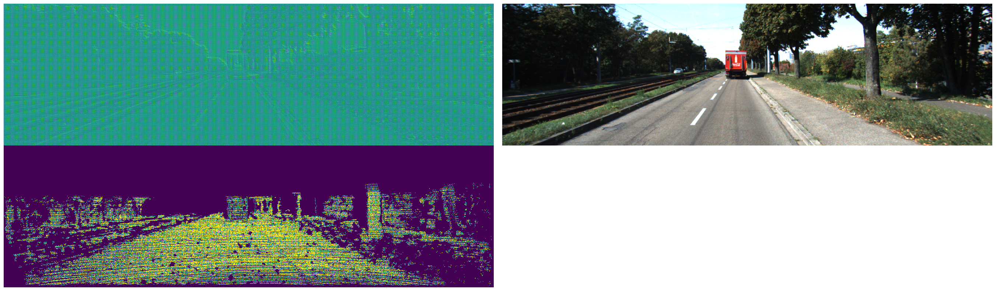

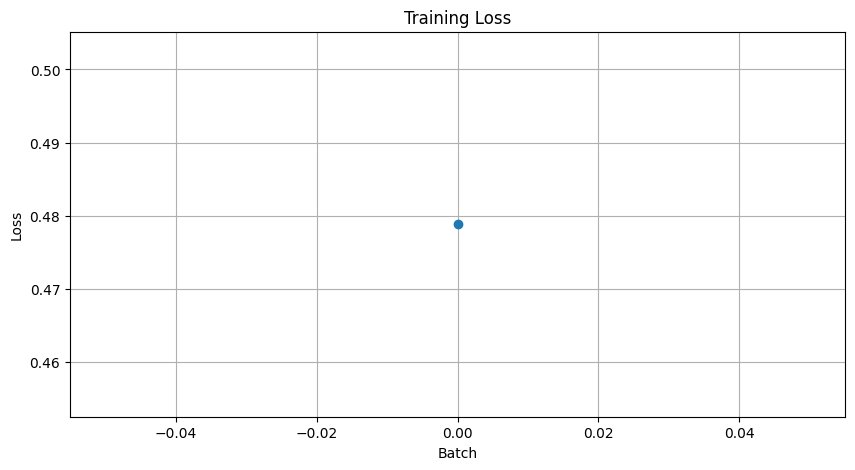

Epoch 1/10:   1%|          | 1/85 [00:02<02:58,  2.12s/it, loss=0.479]

loss: 0.4788223206996918Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:   2%|▏         | 2/85 [00:03<01:58,  1.43s/it, loss=0.923]

loss: 0.9234217405319214Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:   4%|▎         | 3/85 [00:03<01:35,  1.17s/it, loss=0.533]

loss: 0.5331497192382812Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:   5%|▍         | 4/85 [00:04<01:29,  1.10s/it, loss=0.206]

loss: 0.20593474805355072Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:   6%|▌         | 5/85 [00:05<01:25,  1.06s/it, loss=0.415]

loss: 0.4149746596813202Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:   7%|▋         | 6/85 [00:07<01:25,  1.08s/it, loss=0.263]

loss: 0.2632254660129547Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:   8%|▊         | 7/85 [00:08<01:23,  1.07s/it, loss=0.214]

loss: 0.21423359215259552Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:   9%|▉         | 8/85 [00:09<01:21,  1.05s/it, loss=0.309]

loss: 0.3088036775588989Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  11%|█         | 9/85 [00:10<01:18,  1.04s/it, loss=0.172]

loss: 0.1716136336326599Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  12%|█▏        | 10/85 [00:11<01:15,  1.01s/it, loss=0.162]

loss: 0.16226345300674438Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  13%|█▎        | 11/85 [00:11<01:11,  1.03it/s, loss=0.212]

loss: 0.21204818785190582Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  14%|█▍        | 12/85 [00:13<01:13,  1.01s/it, loss=0.14] 

loss: 0.14039397239685059Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  15%|█▌        | 13/85 [00:13<01:11,  1.00it/s, loss=0.093]

loss: 0.0929592177271843Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  16%|█▋        | 14/85 [00:15<01:16,  1.07s/it, loss=0.135]

loss: 0.13454113900661469Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  18%|█▊        | 15/85 [00:16<01:14,  1.06s/it, loss=0.121]

loss: 0.12106021493673325Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  18%|█▊        | 15/85 [00:17<01:14,  1.06s/it, loss=0.086]

<Figure size 1750x500 with 0 Axes>

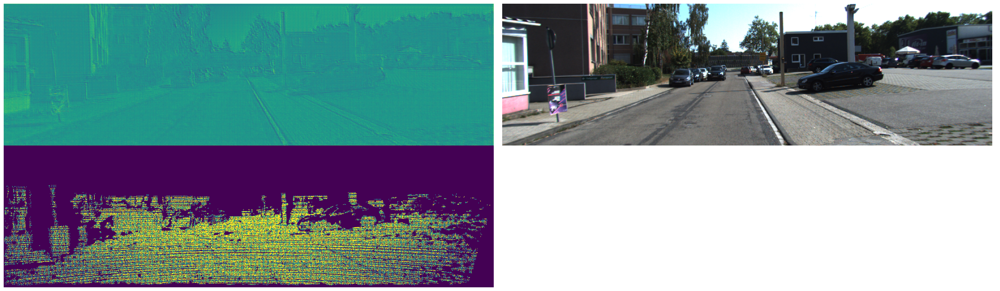

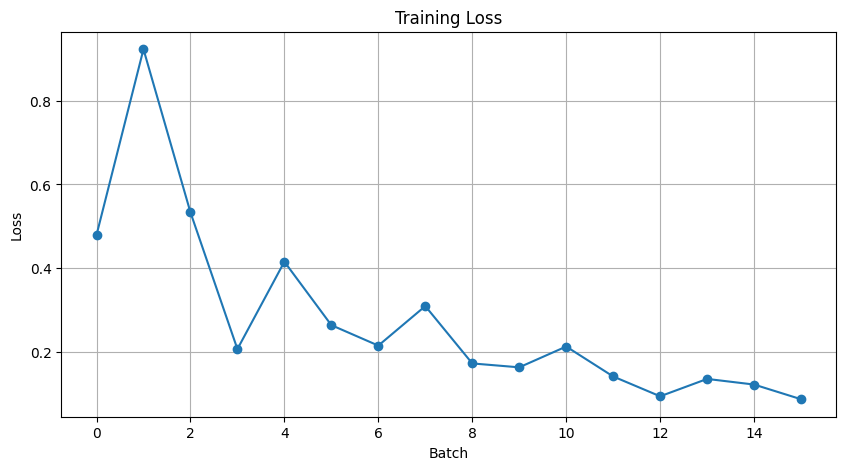

Epoch 1/10:  19%|█▉        | 16/85 [00:18<01:37,  1.41s/it, loss=0.086]

loss: 0.08596114814281464Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  20%|██        | 17/85 [00:19<01:28,  1.30s/it, loss=0.0755]

loss: 0.07553950697183609Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  21%|██        | 18/85 [00:20<01:21,  1.22s/it, loss=0.0909]

loss: 0.0909041091799736Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  22%|██▏       | 19/85 [00:21<01:16,  1.16s/it, loss=0.09]  

loss: 0.08999457210302353Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  24%|██▎       | 20/85 [00:22<01:14,  1.14s/it, loss=0.0835]

loss: 0.08354886621236801Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  25%|██▍       | 21/85 [00:23<01:12,  1.13s/it, loss=0.0608]

loss: 0.060779109597206116Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  26%|██▌       | 22/85 [00:24<01:10,  1.11s/it, loss=0.0549]

loss: 0.05489635095000267Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  27%|██▋       | 23/85 [00:26<01:09,  1.12s/it, loss=0.0658]

loss: 0.06577595323324203Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  28%|██▊       | 24/85 [00:27<01:07,  1.11s/it, loss=0.0658]

loss: 0.06580603122711182Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  29%|██▉       | 25/85 [00:28<01:08,  1.15s/it, loss=0.05]  

loss: 0.04998107999563217Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  31%|███       | 26/85 [00:29<01:07,  1.15s/it, loss=0.0413]

loss: 0.04129001125693321Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  32%|███▏      | 27/85 [00:30<01:07,  1.16s/it, loss=0.0442]

loss: 0.044183529913425446Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  33%|███▎      | 28/85 [00:31<01:03,  1.12s/it, loss=0.0484]

loss: 0.04839204251766205Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  34%|███▍      | 29/85 [00:32<01:04,  1.15s/it, loss=0.0448]

loss: 0.04483877494931221Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  35%|███▌      | 30/85 [00:33<01:02,  1.13s/it, loss=0.036] 

loss: 0.035956721752882004Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  35%|███▌      | 30/85 [00:35<01:02,  1.13s/it, loss=0.0326]

<Figure size 1750x500 with 0 Axes>

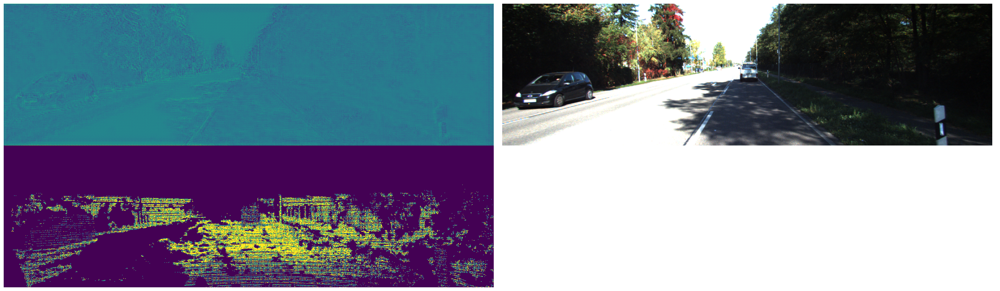

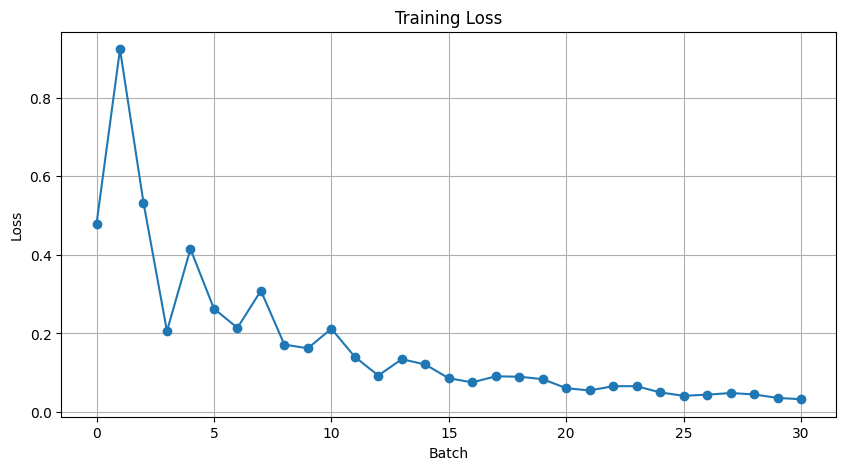

Epoch 1/10:  36%|███▋      | 31/85 [00:36<01:28,  1.64s/it, loss=0.0326]

loss: 0.032622553408145905Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  38%|███▊      | 32/85 [00:37<01:17,  1.46s/it, loss=0.0348]

loss: 0.03479677438735962Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  39%|███▉      | 33/85 [00:38<01:09,  1.34s/it, loss=0.0353]

loss: 0.035254571586847305Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  40%|████      | 34/85 [00:39<01:02,  1.24s/it, loss=0.033] 

loss: 0.03295159712433815Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  41%|████      | 35/85 [00:41<01:00,  1.21s/it, loss=0.0277]

loss: 0.027721691876649857Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  42%|████▏     | 36/85 [00:42<00:56,  1.16s/it, loss=0.0271]

loss: 0.02714371308684349Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  44%|████▎     | 37/85 [00:43<00:54,  1.13s/it, loss=0.0275]

loss: 0.02747216820716858Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  45%|████▍     | 38/85 [00:44<00:51,  1.11s/it, loss=0.0273]

loss: 0.027335744351148605Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  46%|████▌     | 39/85 [00:45<00:50,  1.09s/it, loss=0.0221]

loss: 0.02211025357246399Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  47%|████▋     | 40/85 [00:46<00:46,  1.04s/it, loss=0.0222]

loss: 0.022226804867386818Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  48%|████▊     | 41/85 [00:47<00:45,  1.04s/it, loss=0.0242]

loss: 0.02421552501618862Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  49%|████▉     | 42/85 [00:48<00:44,  1.03s/it, loss=0.0225]

loss: 0.022459695115685463Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  51%|█████     | 43/85 [00:49<00:43,  1.04s/it, loss=0.0191]

loss: 0.019061729311943054Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  52%|█████▏    | 44/85 [00:50<00:41,  1.02s/it, loss=0.0196]

loss: 0.019565869122743607Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  53%|█████▎    | 45/85 [00:51<00:40,  1.02s/it, loss=0.0199]

loss: 0.01988508179783821Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  53%|█████▎    | 45/85 [00:52<00:40,  1.02s/it, loss=0.0194]

<Figure size 1750x500 with 0 Axes>

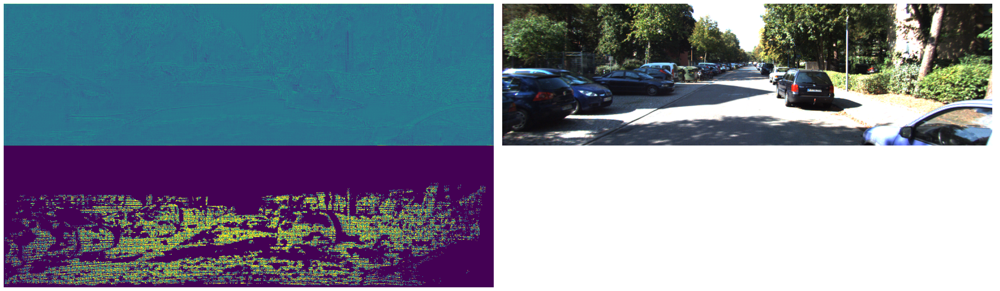

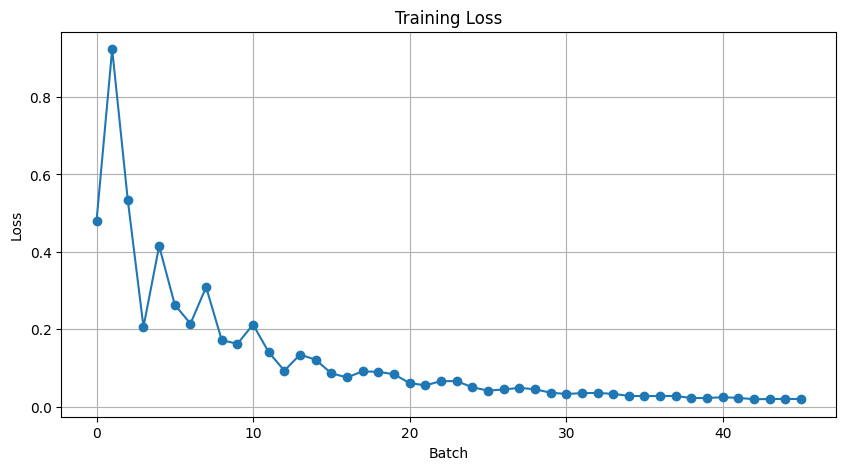

Epoch 1/10:  54%|█████▍    | 46/85 [00:53<00:53,  1.38s/it, loss=0.0194]

loss: 0.019439520314335823Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  55%|█████▌    | 47/85 [00:54<00:48,  1.28s/it, loss=0.0171]

loss: 0.01708257757127285Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  56%|█████▋    | 48/85 [00:55<00:45,  1.24s/it, loss=0.0149]

loss: 0.014853516593575478Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  58%|█████▊    | 49/85 [00:56<00:42,  1.18s/it, loss=0.0167]

loss: 0.016684239730238914Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  59%|█████▉    | 50/85 [00:57<00:40,  1.15s/it, loss=0.014] 

loss: 0.013975027948617935Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  60%|██████    | 51/85 [00:58<00:39,  1.15s/it, loss=0.0156]

loss: 0.015622933395206928Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  61%|██████    | 52/85 [00:59<00:35,  1.09s/it, loss=0.0155]

loss: 0.015507388859987259Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  62%|██████▏   | 53/85 [01:00<00:33,  1.04s/it, loss=0.0149]

loss: 0.014890026301145554Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  64%|██████▎   | 54/85 [01:01<00:30,  1.02it/s, loss=0.0132]

loss: 0.01320598367601633Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  65%|██████▍   | 55/85 [01:02<00:28,  1.05it/s, loss=0.0131]

loss: 0.013065902516245842Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  66%|██████▌   | 56/85 [01:03<00:27,  1.07it/s, loss=0.0139]

loss: 0.013912800699472427Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  67%|██████▋   | 57/85 [01:04<00:26,  1.05it/s, loss=0.0122]

loss: 0.012210673652589321Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  68%|██████▊   | 58/85 [01:05<00:26,  1.04it/s, loss=0.0124]

loss: 0.01243562437593937Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  69%|██████▉   | 59/85 [01:06<00:25,  1.02it/s, loss=0.0119]

loss: 0.011910892091691494Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  71%|███████   | 60/85 [01:07<00:24,  1.04it/s, loss=0.012] 

loss: 0.0119588328525424Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  71%|███████   | 60/85 [01:08<00:24,  1.04it/s, loss=0.011]

<Figure size 1750x500 with 0 Axes>

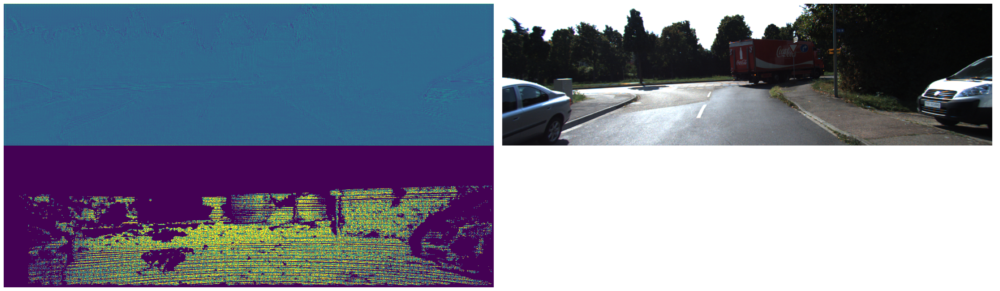

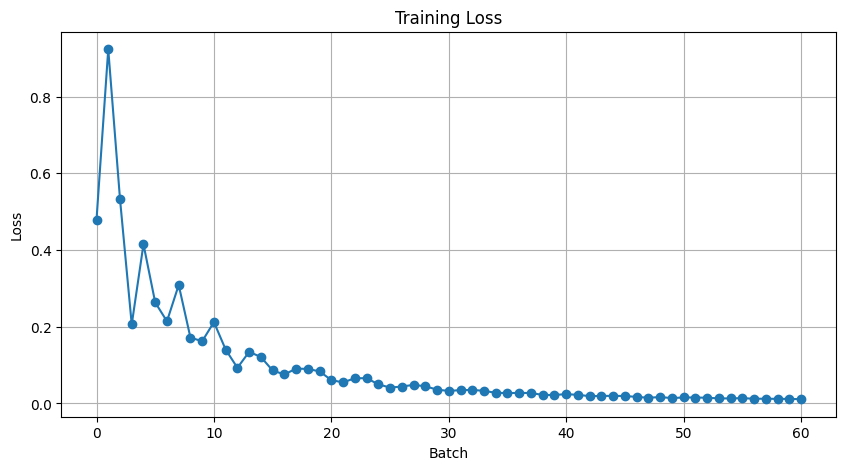

Epoch 1/10:  72%|███████▏  | 61/85 [01:09<00:30,  1.28s/it, loss=0.011]

loss: 0.01103311125189066Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  73%|███████▎  | 62/85 [01:10<00:26,  1.15s/it, loss=0.0116]

loss: 0.011618929915130138Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  74%|███████▍  | 63/85 [01:11<00:23,  1.08s/it, loss=0.0117]

loss: 0.011673777364194393Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  75%|███████▌  | 64/85 [01:12<00:21,  1.03s/it, loss=0.0104]

loss: 0.010358917526900768Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  76%|███████▋  | 65/85 [01:13<00:20,  1.00s/it, loss=0.0108]

loss: 0.010836784727871418Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  78%|███████▊  | 66/85 [01:13<00:18,  1.02it/s, loss=0.012] 

loss: 0.011961349286139011Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  79%|███████▉  | 67/85 [01:14<00:17,  1.05it/s, loss=0.00984]

loss: 0.009838133119046688Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  80%|████████  | 68/85 [01:15<00:16,  1.05it/s, loss=0.0104] 

loss: 0.010362108238041401Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  81%|████████  | 69/85 [01:16<00:14,  1.07it/s, loss=0.0168]

loss: 0.01676420122385025Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  82%|████████▏ | 70/85 [01:17<00:14,  1.06it/s, loss=0.0102]

loss: 0.010187467560172081Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  84%|████████▎ | 71/85 [01:18<00:12,  1.10it/s, loss=0.0128]

loss: 0.012758833356201649Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  85%|████████▍ | 72/85 [01:19<00:12,  1.08it/s, loss=0.0121]

loss: 0.012118333019316196Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  86%|████████▌ | 73/85 [01:20<00:11,  1.06it/s, loss=0.00886]

loss: 0.008860639296472073Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  87%|████████▋ | 74/85 [01:21<00:10,  1.05it/s, loss=0.01]   

loss: 0.010020535439252853Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  88%|████████▊ | 75/85 [01:22<00:09,  1.07it/s, loss=0.0144]

loss: 0.014423266053199768Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  88%|████████▊ | 75/85 [01:23<00:09,  1.07it/s, loss=0.00948]

<Figure size 1750x500 with 0 Axes>

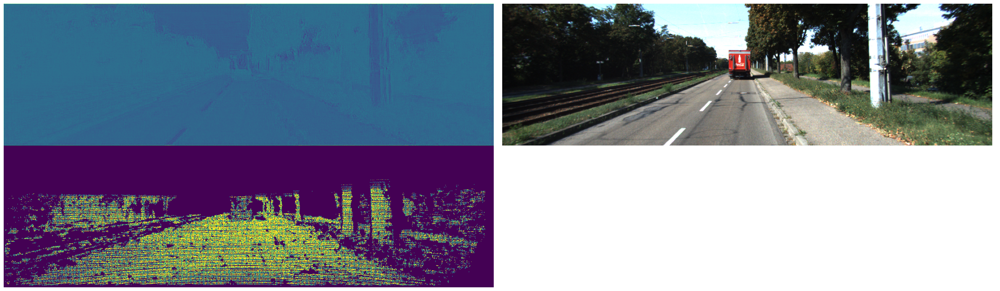

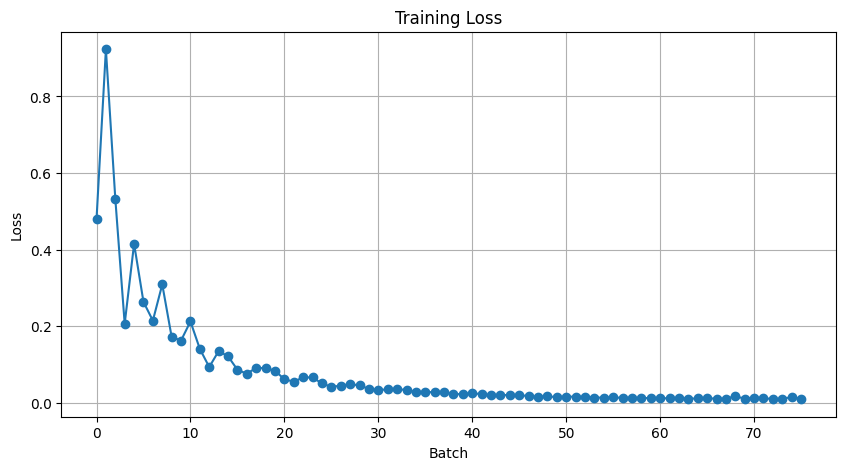

Epoch 1/10:  89%|████████▉ | 76/85 [01:24<00:12,  1.41s/it, loss=0.00948]

loss: 0.00948099885135889Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  91%|█████████ | 77/85 [01:26<00:10,  1.34s/it, loss=0.0114] 

loss: 0.01137701328843832Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  92%|█████████▏| 78/85 [01:27<00:08,  1.28s/it, loss=0.0127]

loss: 0.012661395594477654Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  93%|█████████▎| 79/85 [01:28<00:07,  1.20s/it, loss=0.00826]

loss: 0.008259397000074387Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  94%|█████████▍| 80/85 [01:29<00:05,  1.13s/it, loss=0.0084] 

loss: 0.008403719402849674Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  95%|█████████▌| 81/85 [01:30<00:04,  1.08s/it, loss=0.00854]

loss: 0.008539373055100441Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  96%|█████████▋| 82/85 [01:30<00:03,  1.03s/it, loss=0.00996]

loss: 0.009955203160643578Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  98%|█████████▊| 83/85 [01:31<00:02,  1.00s/it, loss=0.00778]

loss: 0.0077767749316990376Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10:  99%|█████████▉| 84/85 [01:32<00:01,  1.01s/it, loss=0.00774]

loss: 0.007739937398582697Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 1/10: 100%|██████████| 85/85 [01:33<00:00,  1.10s/it, loss=0.012]  


loss: 0.01203965488821268

Epoch 2/10:   0%|          | 0/85 [00:00<?, ?it/s]

Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:   0%|          | 0/85 [00:00<?, ?it/s, loss=0.0087]

<Figure size 1750x500 with 0 Axes>

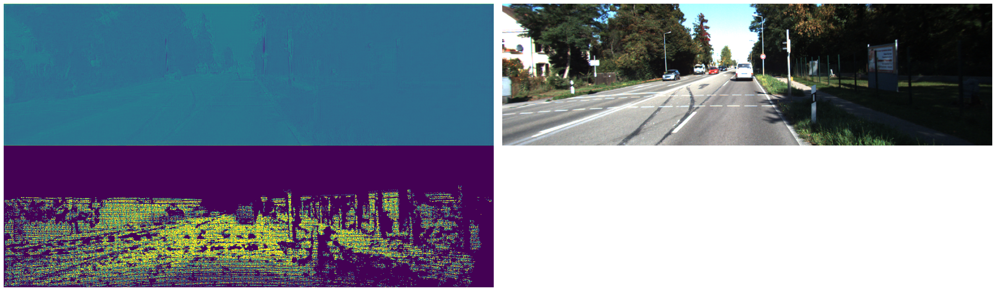

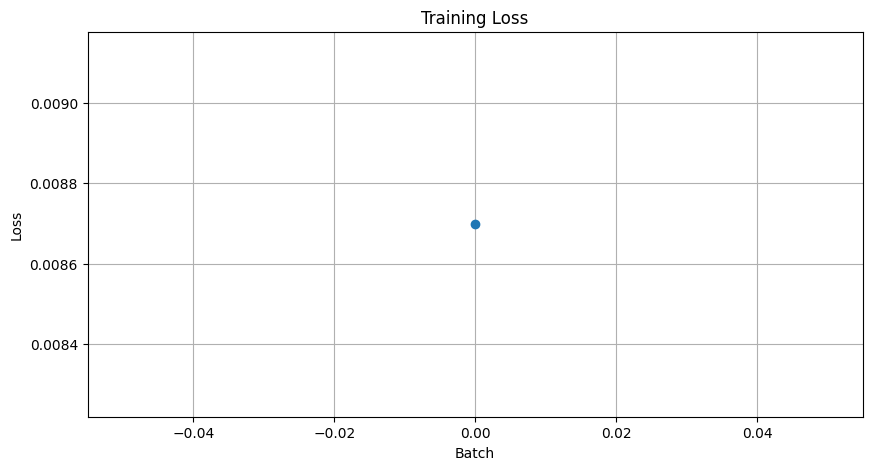

Epoch 2/10:   1%|          | 1/85 [00:01<02:37,  1.88s/it, loss=0.0087]

loss: 0.008698276244103909Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:   2%|▏         | 2/85 [00:02<01:44,  1.25s/it, loss=0.00735]

loss: 0.007352221291512251Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:   4%|▎         | 3/85 [00:03<01:23,  1.02s/it, loss=0.0139] 

loss: 0.013865704648196697Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:   5%|▍         | 4/85 [00:04<01:11,  1.13it/s, loss=0.00952]

loss: 0.009518159553408623Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:   6%|▌         | 5/85 [00:04<01:07,  1.19it/s, loss=0.0114] 

loss: 0.011389873921871185Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:   7%|▋         | 6/85 [00:05<01:02,  1.27it/s, loss=0.0116]

loss: 0.011582912877202034Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:   8%|▊         | 7/85 [00:06<01:00,  1.29it/s, loss=0.00894]

loss: 0.008938849903643131Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:   9%|▉         | 8/85 [00:07<00:59,  1.31it/s, loss=0.0136] 

loss: 0.013594659976661205Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  11%|█         | 9/85 [00:07<01:00,  1.26it/s, loss=0.00987]

loss: 0.00987168587744236Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  12%|█▏        | 10/85 [00:08<00:59,  1.27it/s, loss=0.0109]

loss: 0.010854600928723812Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  13%|█▎        | 11/85 [00:09<00:56,  1.30it/s, loss=0.0109]

loss: 0.010897936299443245Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  14%|█▍        | 12/85 [00:10<00:56,  1.30it/s, loss=0.00798]

loss: 0.007983528077602386Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  15%|█▌        | 13/85 [00:11<00:57,  1.26it/s, loss=0.0134] 

loss: 0.013360066339373589Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  16%|█▋        | 14/85 [00:11<00:58,  1.21it/s, loss=0.00893]

loss: 0.008930348791182041Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  18%|█▊        | 15/85 [00:12<01:00,  1.16it/s, loss=0.00622]

loss: 0.006219226401299238Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  18%|█▊        | 15/85 [00:13<01:00,  1.16it/s, loss=0.011]  

<Figure size 1750x500 with 0 Axes>

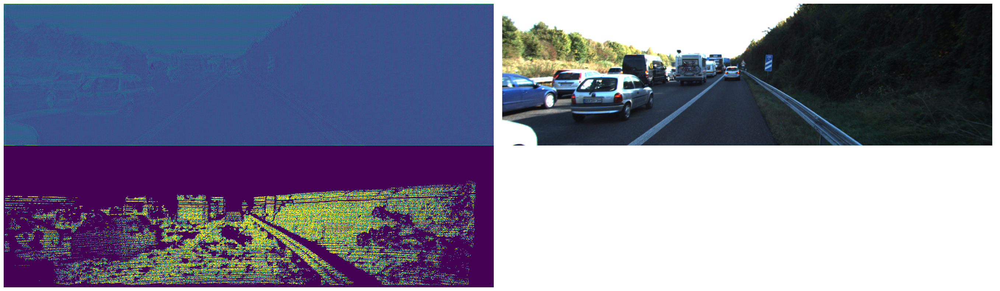

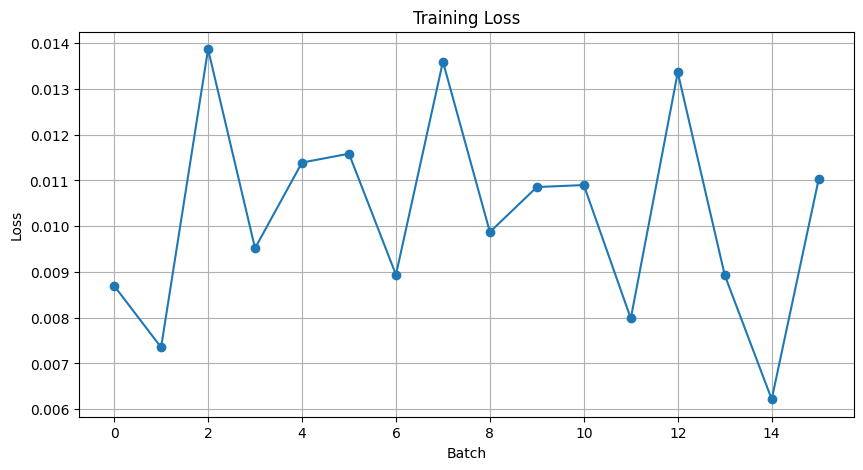

Epoch 2/10:  19%|█▉        | 16/85 [00:15<01:29,  1.29s/it, loss=0.011]

loss: 0.011026824824512005Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  20%|██        | 17/85 [00:15<01:17,  1.13s/it, loss=0.00834]

loss: 0.008343774825334549Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  21%|██        | 18/85 [00:16<01:07,  1.01s/it, loss=0.00798]

loss: 0.007982644252479076Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  22%|██▏       | 19/85 [00:17<01:01,  1.07it/s, loss=0.0092] 

loss: 0.009200379252433777Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  24%|██▎       | 20/85 [00:18<00:59,  1.09it/s, loss=0.00779]

loss: 0.007794780656695366Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  25%|██▍       | 21/85 [00:19<00:55,  1.15it/s, loss=0.00683]

loss: 0.006825627293437719Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  26%|██▌       | 22/85 [00:19<00:53,  1.19it/s, loss=0.0115] 

loss: 0.011516337282955647Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  27%|██▋       | 23/85 [00:20<00:52,  1.19it/s, loss=0.00855]

loss: 0.008554288186132908Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  28%|██▊       | 24/85 [00:21<00:49,  1.22it/s, loss=0.00695]

loss: 0.0069535295478999615Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  29%|██▉       | 25/85 [00:22<00:46,  1.28it/s, loss=0.00838]

loss: 0.008384695276618004Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  31%|███       | 26/85 [00:22<00:46,  1.27it/s, loss=0.0121] 

loss: 0.012057500891387463Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  32%|███▏      | 27/85 [00:23<00:45,  1.28it/s, loss=0.00794]

loss: 0.007936554029583931Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  33%|███▎      | 28/85 [00:24<00:44,  1.29it/s, loss=0.01]   

loss: 0.010026377625763416Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  34%|███▍      | 29/85 [00:25<00:44,  1.27it/s, loss=0.0146]

loss: 0.014636078849434853Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  35%|███▌      | 30/85 [00:26<00:44,  1.25it/s, loss=0.0101]

loss: 0.010067694820463657Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  35%|███▌      | 30/85 [00:26<00:44,  1.25it/s, loss=0.00884]

<Figure size 1750x500 with 0 Axes>

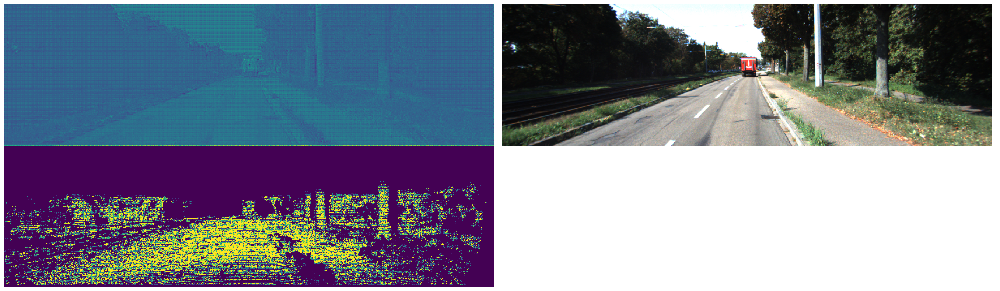

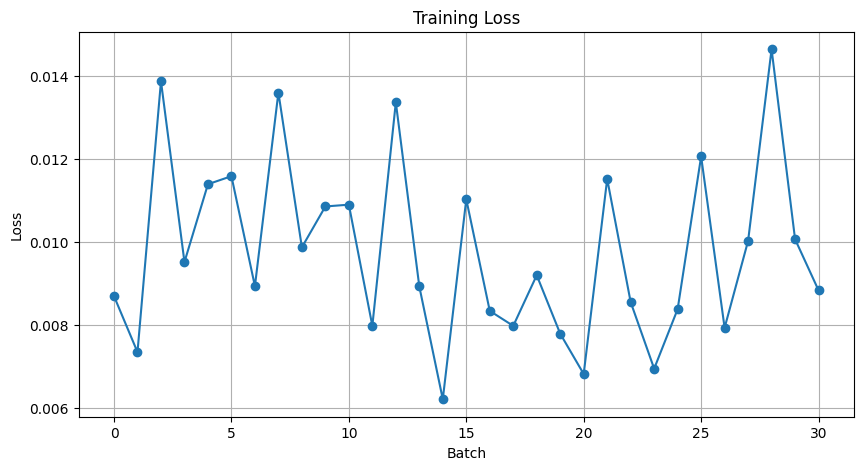

Epoch 2/10:  36%|███▋      | 31/85 [00:28<01:09,  1.29s/it, loss=0.00884]

loss: 0.00883787963539362Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  38%|███▊      | 32/85 [00:29<01:01,  1.16s/it, loss=0.00676]

loss: 0.006756702437996864Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  39%|███▉      | 33/85 [00:30<00:54,  1.05s/it, loss=0.00905]

loss: 0.009054796770215034Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  40%|████      | 34/85 [00:31<00:52,  1.03s/it, loss=0.0111] 

loss: 0.01113767921924591Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  41%|████      | 35/85 [00:32<00:49,  1.02it/s, loss=0.00866]

loss: 0.008661688305437565Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  42%|████▏     | 36/85 [00:32<00:46,  1.06it/s, loss=0.00867]

loss: 0.008670124225318432Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  44%|████▎     | 37/85 [00:33<00:42,  1.14it/s, loss=0.0104] 

loss: 0.010351371951401234Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  45%|████▍     | 38/85 [00:34<00:40,  1.15it/s, loss=0.00719]

loss: 0.007185467053204775Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  46%|████▌     | 39/85 [00:35<00:39,  1.17it/s, loss=0.00715]

loss: 0.007152652367949486Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  47%|████▋     | 40/85 [00:35<00:36,  1.24it/s, loss=0.00889]

loss: 0.008889458142220974Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  48%|████▊     | 41/85 [00:36<00:35,  1.22it/s, loss=0.00736]

loss: 0.007355773821473122Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  49%|████▉     | 42/85 [00:37<00:35,  1.22it/s, loss=0.00553]

loss: 0.005527660250663757Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  51%|█████     | 43/85 [00:38<00:33,  1.25it/s, loss=0.00987]

loss: 0.009865598753094673Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  52%|█████▏    | 44/85 [00:39<00:32,  1.25it/s, loss=0.00774]

loss: 0.007736833766102791Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  53%|█████▎    | 45/85 [00:40<00:32,  1.25it/s, loss=0.00646]

loss: 0.006457200273871422Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  53%|█████▎    | 45/85 [00:40<00:32,  1.25it/s, loss=0.00908]

<Figure size 1750x500 with 0 Axes>

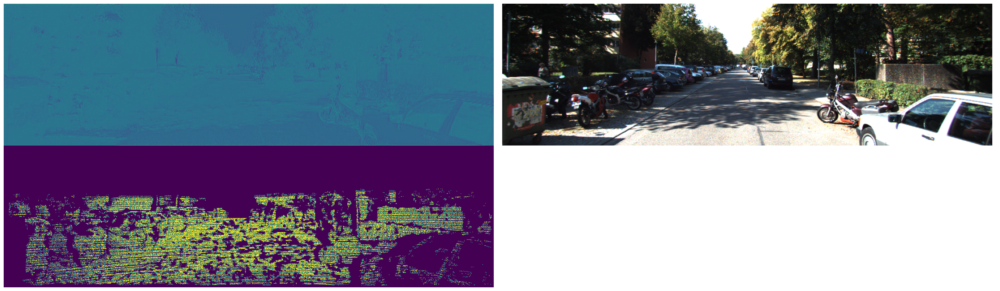

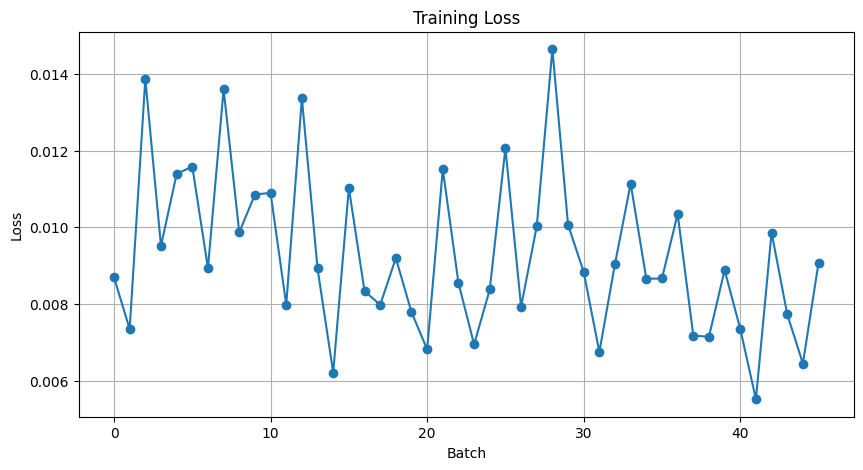

Epoch 2/10:  54%|█████▍    | 46/85 [00:42<00:45,  1.17s/it, loss=0.00908]

loss: 0.0090811001136899Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  55%|█████▌    | 47/85 [00:42<00:41,  1.10s/it, loss=0.0087] 

loss: 0.008702333085238934Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  56%|█████▋    | 48/85 [00:43<00:37,  1.00s/it, loss=0.00766]

loss: 0.007655269932001829Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  58%|█████▊    | 49/85 [00:44<00:33,  1.07it/s, loss=0.00784]

loss: 0.00784437544643879Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  59%|█████▉    | 50/85 [00:45<00:31,  1.12it/s, loss=0.00714]

loss: 0.0071351961232721806Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  60%|██████    | 51/85 [00:46<00:29,  1.17it/s, loss=0.00736]

loss: 0.00735731516033411Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  61%|██████    | 52/85 [00:46<00:27,  1.19it/s, loss=0.00978]

loss: 0.009775967337191105Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  62%|██████▏   | 53/85 [00:47<00:27,  1.18it/s, loss=0.0094] 

loss: 0.009402102790772915Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  64%|██████▎   | 54/85 [00:48<00:25,  1.21it/s, loss=0.00565]

loss: 0.005645638331770897Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  65%|██████▍   | 55/85 [00:49<00:25,  1.16it/s, loss=0.00924]

loss: 0.009243395179510117Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  66%|██████▌   | 56/85 [00:50<00:25,  1.15it/s, loss=0.00902]

loss: 0.0090230917558074Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  67%|██████▋   | 57/85 [00:51<00:24,  1.16it/s, loss=0.00737]

loss: 0.007373797707259655Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  68%|██████▊   | 58/85 [00:52<00:23,  1.14it/s, loss=0.00737]

loss: 0.007371253799647093Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  69%|██████▉   | 59/85 [00:53<00:23,  1.11it/s, loss=0.007]  

loss: 0.007002679631114006Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  71%|███████   | 60/85 [00:53<00:21,  1.16it/s, loss=0.00805]

loss: 0.008047768846154213Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  71%|███████   | 60/85 [00:54<00:21,  1.16it/s, loss=0.00497]

<Figure size 1750x500 with 0 Axes>

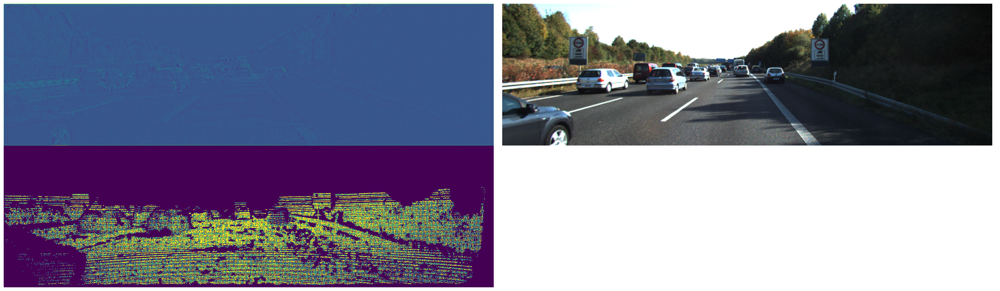

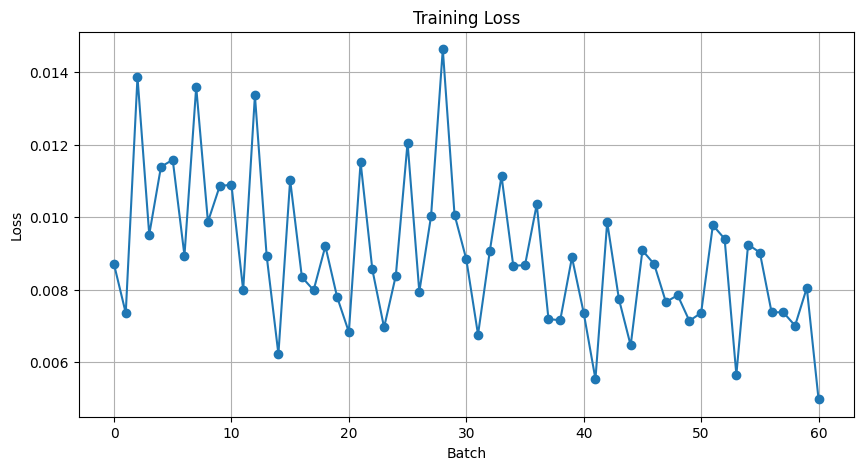

Epoch 2/10:  72%|███████▏  | 61/85 [00:55<00:29,  1.25s/it, loss=0.00497]

loss: 0.004972001072019339Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  73%|███████▎  | 62/85 [00:56<00:26,  1.13s/it, loss=0.00926]

loss: 0.009261609055101871Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  74%|███████▍  | 63/85 [00:57<00:23,  1.07s/it, loss=0.00908]

loss: 0.009080146439373493Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  75%|███████▌  | 64/85 [00:58<00:20,  1.01it/s, loss=0.00747]

loss: 0.0074735707603394985Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  76%|███████▋  | 65/85 [00:59<00:18,  1.07it/s, loss=0.0114] 

loss: 0.01139776036143303Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  78%|███████▊  | 66/85 [01:00<00:16,  1.12it/s, loss=0.0107]

loss: 0.010698596015572548Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  79%|███████▉  | 67/85 [01:01<00:16,  1.12it/s, loss=0.012] 

loss: 0.0120314946398139Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  80%|████████  | 68/85 [01:01<00:14,  1.19it/s, loss=0.00978]

loss: 0.009775100275874138Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  81%|████████  | 69/85 [01:02<00:13,  1.17it/s, loss=0.0128] 

loss: 0.012778976932168007Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  82%|████████▏ | 70/85 [01:03<00:12,  1.16it/s, loss=0.00978]

loss: 0.009777733124792576Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  84%|████████▎ | 71/85 [01:04<00:11,  1.17it/s, loss=0.00775]

loss: 0.007752089761197567Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  85%|████████▍ | 72/85 [01:05<00:11,  1.12it/s, loss=0.00943]

loss: 0.009432799182832241Shape of input: torch.Size([8, 3, 352, 1216])
Shape of encoder output 1: torch.Size([8, 64, 176, 608])
Shape of encoder output 2: torch.Size([8, 64, 88, 304])
Shape of encoder output 3: torch.Size([8, 128, 44, 152])
Shape of concat 1: torch.Size([8, 128, 88, 304]), should be [8, 128, 88, 304]
Shape of conv 1: torch.Size([8, 64, 88, 304]), should be [8, 64, 88, 304]
Shape of concat 2: torch.Size([8, 128, 176, 608]), should be [8, 128, 176, 608]
Shape of conv 2: torch.Size([8, 64, 176, 608]), should be [8, 64, 176, 608]
Shape of concat 3: torch.Size([8, 67, 352, 1216]), should be [8, 64+3, 352, 1216]
Shape of conv 3: torch.Size([8, 1, 352, 1216]), should be [8, 1, 352, 1216]


Epoch 2/10:  85%|████████▍ | 72/85 [01:06<00:11,  1.09it/s, loss=0.00943]


KeyboardInterrupt: 

In [31]:
# # Usage example:
# model = DenseNetBackbone()
# input_tensor = torch.randn(1, 3, 480, 640)  # Example input shape (batch_size, channels, height, width)
# output = model(input_tensor)


# remove 8 layers to get a latent space that is half of the size of the input
# input: [8, 3, 352, 1216]
# 8 -> [8, 64, 176, 608]    (1/2)
# 7 -> [8, 64, 176, 608]    (1/2)
# 6 -> [8, 64, 88, 304]     (1/4)
# 5 -> [8, 64, 88, 304]     (1/4)
# 4 -> [8, 128, 44, 152]    (1/8)
# 3 -> [8, 256, 22, 76]     (1/16)
# 2 -> [8, 512, 11, 38]     (1/32)
# model = ResNet18Backbone(remove=7, pretrained=True)
model = ResNet18BackboneConcat(pretrained=True)


criterion = MaskedL1Loss()
# criterion = nn.L1Loss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = StepLR(optimizer, step_size=40, gamma=1)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

train(model, trainloader, criterion, optimizer, epochs=10)
evaluate(model, valloader, criterion)
# TypeError: Invalid shape (352, 1216, 64) for image data